# Aggregate TFIDF

```yaml
course:   DS 5001 
module:   05 5 Lab
topic:    Aggregate TFIDF
author:   R.C. Alvarado
date:     13 February 2024
```

# Overview

Recall Luhn's (1958) representation of the problem:

<img src="luhn.png"/>

In this notebook, we look at ways to approximate Luhn's significance curve using the ideas we learned in this module.

# Set Up

## Import

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly_express as px

In [2]:
sns.set()

## Config

Change this to match the location of your data files.

In [3]:
import configparser
config = configparser.ConfigParser()
config.read("../../../env.ini")
data_home = config['DEFAULT']['data_home'] 
output_dir = config['DEFAULT']['output_dir']
data_prefix = 'austen-melville'

In [8]:
OHCO = ['book_id', 'chap_id', 'para_num', 'sent_num', 'token_num']
bags = dict(
    SENTS = OHCO[:4],
    PARAS = OHCO[:3],
    CHAPS = OHCO[:2],
    BOOKS = OHCO[:1]
)

In [9]:
# bag = 'BOOKS'
bag = 'CHAPS'

# Prepare the data

## Import tables

In [10]:
LIB = pd.read_csv(f"{output_dir}/{data_prefix}-LIB.csv").set_index('book_id')
TOKEN = pd.read_csv(f'{output_dir}/{data_prefix}-CORPUS.csv').set_index(OHCO).dropna()
VOCAB = pd.read_csv(f'{output_dir}/{data_prefix}-VOCAB-{bag}.csv').set_index('term_str').dropna()
BOW = pd.read_csv(f'{output_dir}/{data_prefix}-BOW-{bag}.csv').set_index(bags[bag]+['term_str'])
DTCM = pd.read_csv(f'{output_dir}/{data_prefix}-DTCM-{bag}.csv').set_index(bags[bag]) 
TFIDF = pd.read_csv(f'{output_dir}/{data_prefix}-TFIDF-{bag}.csv').set_index(bags[bag])
DOC = pd.read_csv(f'{output_dir}/{data_prefix}-DOC-{bag}.csv').set_index(bags[bag])

Hmmm ...

In [11]:
(VOCAB.df > VOCAB.n).sum()

0

In [12]:
VOCAB['n2'] = DTCM.sum()

In [13]:
VOCAB['p2'] = VOCAB.n2 / VOCAB.n2.sum()

In [14]:
VOCAB['i2'] = -np.log2(VOCAB.p2)

In [15]:
# VOCAB.plot.scatter('i','i2')

# Apply aggregates to VOCAB

In [16]:
VOCAB['tfidf_mean'] = TFIDF.mean() 
VOCAB['tfidf_sum'] = TFIDF.sum()

## Add DFIDF and DH

Instead of aggregating TFIDF values, try estimating the their weights over documents directly.

Do this in two ways:

1. Based on a variation on the TF-IDF formula.
2. Just estimate the entropy of terms over documents.

In [17]:
VOCAB['dfidf'] = VOCAB.df * VOCAB.idf
VOCAB['dp'] = VOCAB.df / len(DOC)
VOCAB['di'] = np.log2(1/VOCAB.dp)
VOCAB['dh'] = VOCAB.dp * VOCAB.di

## Observe results

In [18]:
VOCAB.sample(25).sort_values('di', ascending=True)[['max_pos', 'n2', 'i2','tfidf_mean','tfidf_sum', 'dfidf', 'di', 'dh']]\
    .style.background_gradient(cmap='YlGnBu')

,max_pos,n2,i2,tfidf_mean,tfidf_sum,dfidf,di,dh
term_str,,,,,,,,
port,NN,219,13.198679,0.000334,0.395925,412.728287,3.199444,0.348294
printed,VBN,43,15.547201,0.000122,0.144132,177.848591,5.081388,0.150083
smoked,VBD,23,16.449904,0.000080,0.094559,108.733434,6.040746,0.091758
loaf,NN,19,16.725539,0.000059,0.070218,79.508506,6.625709,0.067096
shire,NN,13,17.273026,0.000032,0.037611,68.887432,6.888743,0.058133
bared,VBN,10,17.651538,0.000036,0.043164,68.887432,6.888743,0.058133
despot,NN,7,18.166111,0.000032,0.037566,51.823215,7.403316,0.043733
divineness,NN,7,18.166111,0.000033,0.038875,45.754253,7.625709,0.038611
eluding,VBG,4,18.973466,0.000040,0.047938,32.842685,8.210671,0.027715


# Visualize

Try to pick the best aggregate statistic.

## Information and TFIDF Mean 

In [19]:
px.scatter(VOCAB.reset_index(), x='i2', y='tfidf_mean', 
           hover_name='term_str', hover_data=['n'], color='max_pos', 
           log_x=False, log_y=False, height=500, width=700)

## Information and TFIDF Sum

In [20]:
px.scatter(VOCAB.reset_index(), x='i2', y='tfidf_sum', 
           hover_name='term_str', hover_data=['n'], color='max_pos', 
           height=500, width=700)

## Information and DFIDF

In [51]:
px.scatter(VOCAB.reset_index(), x='i2', y='dfidf', 
           hover_name='term_str', hover_data=['n'],
           color='max_pos', 
           height=500, width=800)

In [28]:
px.line(VOCAB.reset_index(), x='i2', y='n', 
           hover_name='term_str', hover_data=['n'], 
           height=500, width=800)

In [45]:
# go.Scatter?
# plotly.graph_objects.scatter.Marker?

Object `plotly.graph_objects.scatter.Marker` not found.


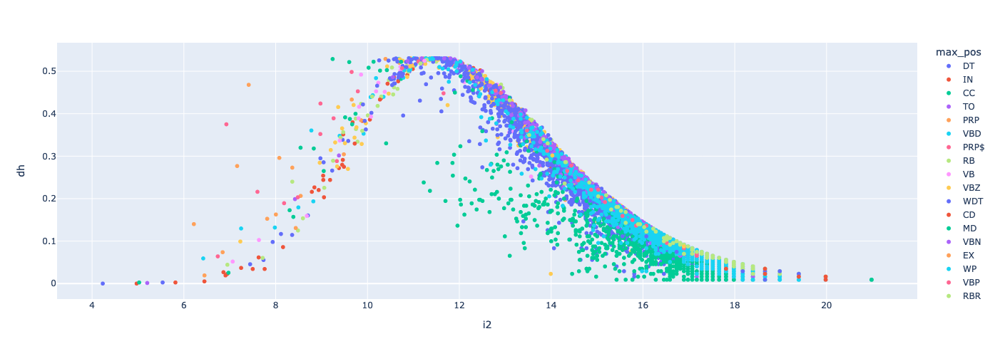

In [ ]:
px.scatter(VOCAB.reset_index(), x='i2', y='dh', 
           hover_name='term_str', hover_data=['n'], 
           color='max_pos', height=500, width=800)

In [23]:
px.scatter(VOCAB.reset_index(), x='dfidf', y='dh', 
           hover_name='term_str', hover_data=['n2'],
           color='max_pos', height=500, width=700)

## Luhn's Graph

In [55]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from plotly.offline import plot, iplot, init_notebook_mode
init_notebook_mode(connected=False)

V = VOCAB.reset_index()

trace1 = go.Scatter(
     x=V.i2, 
     y=V.dh, 
     name='Document Entropy',
     mode='markers'
)

trace2 = go.Scatter(
    x=V.i2,
    y=V.n,
    name='Term Frequency (i)'
)

fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(trace1)
fig.add_trace(trace2, secondary_y=True)
fig['layout'].update(height = 600, width = 1000, 
      title = "Luhn",
      xaxis=dict(tickangle=-90))
iplot(fig)

## Demo Table

In [ ]:
rank_index = [1, 2, 3, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 2000, 3000, 4000, 5000, 6000, 7000, 8000]

In [ ]:
demo2 = VOCAB.loc[VOCAB.term_rank.isin(rank_index), 
                  ['max_pos', 'i2', 'tfidf_mean', 'tfidf_sum', 'dfidf', 'dh']]

In [ ]:
demo2.style.background_gradient(cmap='YlGnBu')

,max_pos,i2,tfidf_mean,tfidf_sum,dfidf,dh
term_str,,,,,,
the,DT,4.232281,0.000000,0.000000,0.000000,0.000000
of,IN,4.970618,0.000000,0.000000,0.000000,0.000000
and,CC,5.025539,0.000079,0.088788,2.882817,0.002569
it,PRP,6.448227,0.000208,0.233208,21.495121,0.019158
you,PRP,7.160265,0.002240,2.513699,310.618692,0.276844
so,RB,7.715761,0.000293,0.329229,67.746505,0.060380
their,PRP$,8.183388,0.000777,0.871750,212.307769,0.189223
are,VBP,8.482293,0.000683,0.766291,228.069595,0.203271
will,MD,8.829627,0.000935,1.049116,356.913125,0.318104


# Reduce VOCAB

## Select Significant Terms based on DFIDF

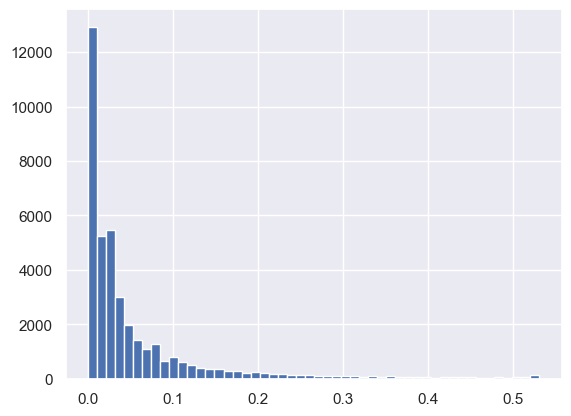

In [ ]:
VOCAB.dh.hist(bins=50);

In [ ]:
SIGS = VOCAB.sort_values('dh', ascending=False).head(4000)

In [ ]:
SIGS[['max_pos', 'n2', 'i2', 'dh']].head(25).style.background_gradient(cmap='YlGnBu')

,max_pos,n2,i2,dh
term_str,,,,
hands,NNS,764,11.403215,0.530737
sure,JJ,1059,10.932157,0.530737
short,JJ,700,11.529433,0.530735
new,JJ,786,11.362258,0.530726
word,NN,709,11.511002,0.530726
passed,VBN,689,11.552284,0.530722
fine,JJ,743,11.443425,0.530716
name,NN,731,11.466916,0.530710
sight,NN,684,11.562791,0.530702


# Save Work

In [ ]:
save_path = f"{output_dir}/{data_prefix}"
SIGS.to_csv(f'{save_path}-SIGS-{bag}.csv')
TFIDF[SIGS.index].to_csv(f'{save_path}-TFIDF_REDUCED-{bag}.csv')